# ASAS-SN and TESS Photometry

In [1]:
import numpy as np
import matplotlib.pyplot as plt

data_dir = 'data/ASAS-SN/'
bands = ['V', 'g']

In [2]:
data = {}
keys = ('JD', 'FWHM', 'limit', 'mJy', 'dmJy')
for band in bands:
    d = np.loadtxt(f"{data_dir}/TIC350842552_ASASSN_{band}_app3.0.dat",
                   usecols=(0,4,6,11,12))
    quality_mask = (d[:,-1] < 50) & (d[:,1] < 2)
    data[band] = {k: v[quality_mask] for k, v in zip(keys, d.T)}
    
# let's combine everything

acc = {}
for k in keys:
    acc[k] = np.concatenate([data[b][k] for b in bands])
    
acc['band'] = np.concatenate([np.ones(len(data[b]['JD'])) * i for i, b in enumerate(bands)]).astype(int)
a = np.argsort(acc['JD'])

for k in acc:
    acc[k] = acc[k][a]
    
data = acc

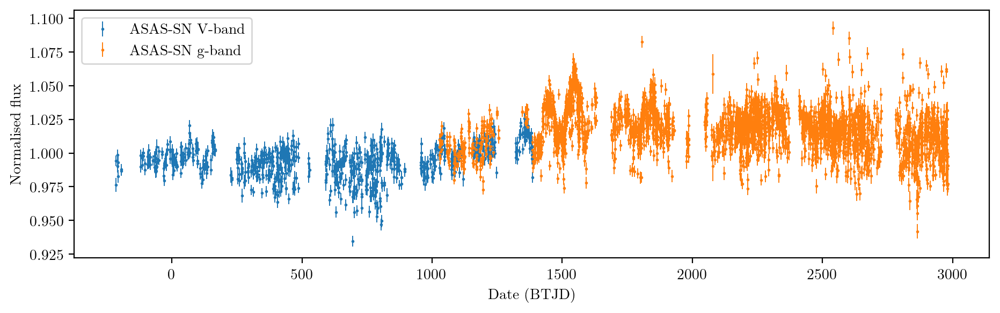

In [3]:
# we know that there is some overlap between
# data taken with the two bands

overlap_bounds = (np.min(data['JD'][data['band'] == 1]), np.max(data['JD'][data['band'] == 0]))

scl = np.ones(len(bands), dtype=int)
for i, band in enumerate(bands):
    m = (lambda t, b: (t>=b[0])&(t<=b[1]))(data['JD'][data['band'] == i], overlap_bounds)
#     m = slice(None, None)
    scl[i] = np.average(data['mJy'][data['band'] == i][m], weights=1/data['mJy'][data['band'] == i][m]**2)
    
# manual adjustment
# scl[1] *= 1.01

for i, band in enumerate(bands):
    m = data['band'] == i
    plt.errorbar(data['JD'][m] - 2457000,
                 data['mJy'][m]/scl[data['band'][m]], yerr=data['dmJy'][m]/scl[data['band'][m]],
                 fmt='.', markersize=2, lw=.7, label=f"ASAS-SN {band}-band")

plt.xlabel(r"Date (BTJD)")
plt.ylabel(r"Normalised flux")
plt.gcf().set_size_inches(20, 6)
plt.savefig('figures/asas-sn-lc.png', dpi=300, bbox_inches='tight')

plt.legend()
plt.gcf().set_size_inches(11, 3)
plt.savefig('figures/asas-sn-lc.pdf', dpi=300, bbox_inches='tight')

In [137]:
# it seems like the long-term variability has been detrended out of the TESS data!
# I had to make my own lightcurve out of the short-cadence TPFs.

tess_data = np.load("data/TIC350842552.npy", allow_pickle=True)[()]
tess_chunks = []

tt = []
ff = []
ee = []

for i, (t, f, e_f, m) in enumerate(zip(tess_data['t'], tess_data['flux_norm'], tess_data['flux_err_norm'], tess_data['outlier_masks'])):
        
    tt.append(t[m])
    ff.append(f[m])
    ee.append(e_f[m])
    
    if i+1 == len(tess_data['t']) or tess_data['t'][i+1][0] - t[-1] > 5:
        tess_chunks.append([np.concatenate(tt), np.concatenate(ff), np.concatenate(ee)])
        tt = []; ff = []; ee = []
    
tess_scl = []
    
for t, f, e_f in tess_chunks:
    
    bounds = np.min(t), np.max(t)
    mask = (data['JD'] >= bounds[0]) & (data['JD'] <= bounds[1])
    t_ref = data['JD'][mask]
    f_ref = data['mJy'][mask]/scl[data['band'][mask]]
    e_ref = data['dmJy'][mask]/scl[data['band'][mask]]
    
    norm = np.sqrt(
        np.median(np.polyval(np.polyfit(t, f, 1, w=1/e_f), t_ref)/f_ref) * 
        np.median(f/np.polyval(np.polyfit(t_ref, f_ref, 1, w=1/e_ref), t)))
    
    tess_scl.append(norm)
    
bands = ['ASAS-SN V', 'ASAS-SN g', 'TESS 1', 'TESS 3', 'TESS 3b', 'TESS 4']

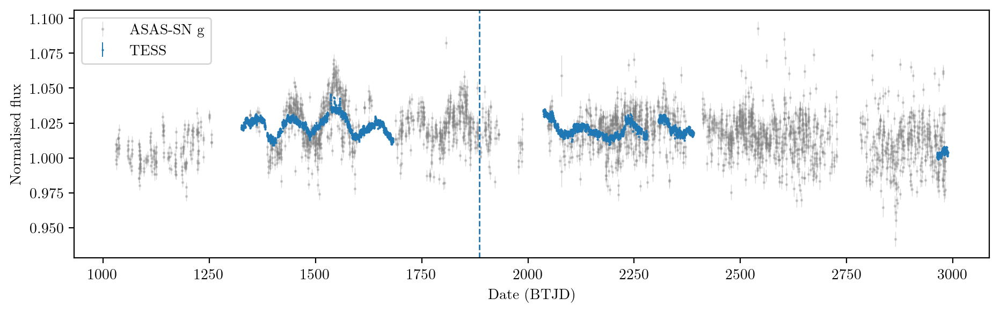

In [6]:
# Prot = 97.8
# t0 = tess_data['t'][-1][0]

Prot = np.inf
t0 = 2457000

for i, band in enumerate(bands[:2]):
    if i == 0:
        continue
    m = data['band'] == i
    plt.errorbar((data['JD'][m] - t0) % Prot,
                 data['mJy'][m]/scl[i], yerr=data['dmJy'][m]/scl[i], fmt='.',
                 c='gray', markersize=2, lw=.5, label=f"{band}", alpha=.3, zorder=-1)

for i, ((t, f, e_f), norm) in enumerate(zip(tess_chunks, tess_scl)):
    
    er = plt.errorbar((t[::100] - t0) % Prot, f[::100]/norm, yerr=e_f[::100]/norm, lw=.7, markersize=1,
                      fmt='.', label='TESS' if not i else None, c=f"C0")
    
plt.axvline(1886, ls='dashed', lw=1)

plt.xlabel(r"Date (BTJD)")
plt.ylabel(r"Normalised flux")
plt.gcf().set_size_inches(20, 6)
plt.savefig('figures/tess-lc.png', dpi=300, bbox_inches='tight')

plt.legend()
plt.gcf().set_size_inches(11, 3)
plt.savefig('figures/tess-lc.pdf', dpi=300, bbox_inches='tight')
plt.show()

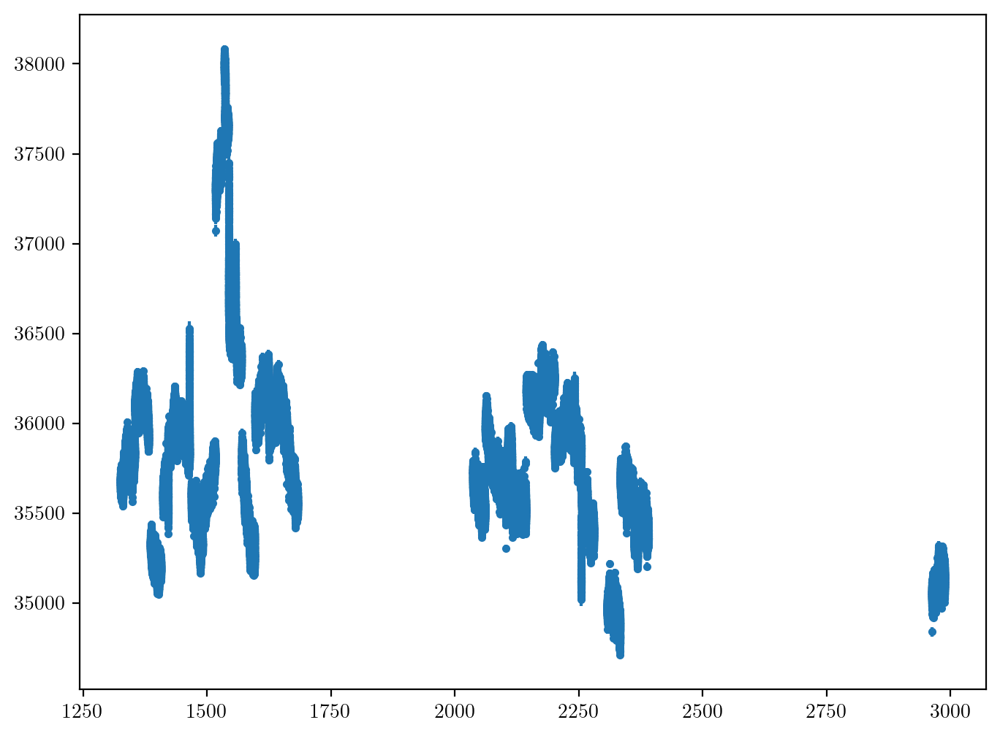

In [7]:
from scipy.interpolate import UnivariateSpline

N = 12

all_t = np.concatenate(tess_data['t']) - t0
# smooth = [UnivariateSpline(t[::N], f[::N], w=1/e_f[::N]) for t, f, e_f in tess_chunks]
# all_y = np.concatenate([f/s(t) for  ((t, f, e_f), s) in zip(tess_chunks, smooth)])
# all_e = np.concatenate([e_f/s(t) for  ((t, f, e_f), s) in zip(tess_chunks, smooth)])
all_y = np.concatenate(tess_data['flux'])
all_e = np.concatenate(tess_data['flux_err'])

# s = (all_t > (2.2507e3+.01)) & (all_t < (2.2507e3+.035))
s = slice(None, None)

plt.errorbar(all_t[s], all_y[s], yerr=all_e[s], fmt='.')
plt.show()

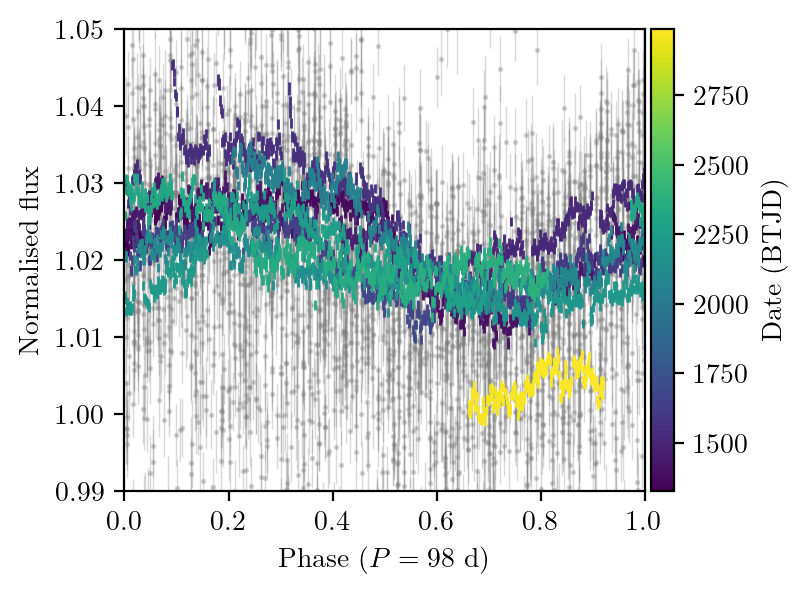

In [8]:
from mesa_tricks.plots import ColorBarHelper

Prot = 98
t0 = 0#tess_data['t'][-1][0]

# Prot = np.inf
# t0 = 2457000

c = ColorBarHelper(np.concatenate(tess_data['t'])-2457000)
s = np.median(np.concatenate(tess_data['flux']))

for i, band in enumerate(bands[:2]):
    if i == 0:
        continue
    m = data['band'] == i
    plt.errorbar((data['JD'][m] - t0) % Prot / Prot,
                 data['mJy'][m]/scl[i], yerr=data['dmJy'][m]/scl[i], fmt='.',
                 c='gray', markersize=2, lw=.5, label=f"{band}", alpha=.3, zorder=-1)

for i, ((t, f, e_f), norm) in enumerate(zip(tess_chunks, tess_scl)):
    
    er = plt.errorbar((t[::100] - t0) % Prot / Prot, f[::100]/norm, yerr=e_f[::100]/norm, lw=1,
                      fmt='none', label='TESS' if not i else None)
    for q in (er[-1]):
        q.set_color(c(t[::100]-2457000))
        
plt.ylim(.99, 1.05)
plt.xlim(0, 1)
plt.xlabel(r"Phase ($P = 98\ \mathrm{d}$)")
plt.ylabel(r"Normalised flux")

c.colorbar(label=f"Date (BTJD)", pad=.01)

plt.gcf().set_size_inches(4,3)
plt.savefig('figures/tess-lc-phased.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [9]:
# Let's combine all of these data sets together

s = slice(None, None, 1)

x = np.concatenate([data['JD'], *[_[0][s] for _ in tess_chunks]])
y = np.concatenate([data['mJy']/scl[data['band']], *[_[1][s]/tess_scl[i] for i, _ in enumerate(tess_chunks)]])
e_y = np.concatenate([data['dmJy']/scl[data['band']], *[_[2][s]/tess_scl[i] for i, _ in enumerate(tess_chunks)]])
z = np.concatenate([data['band'], *[np.full_like(_[0][s], f"{int(i+2)}") for i, _ in enumerate(tess_chunks)]])

# detrend data

y = y - np.polyval(np.polyfit(x, y, 2, w=1/e_y), x)

# sort by time

a = np.argsort(x)

x = x[a]
y = y[a]
e_y = e_y[a]
z = z[a]

In [13]:
dims = {'pdf': (2,3), 'svg': (6,3)}

ASAS-SN V: 1000.0 d
ASAS-SN g: 98.0608713250686 d
TESS 1: 95.7173122852146 d
TESS 3: 93.1074628133199 d
Combined: 97.72259645331101 d


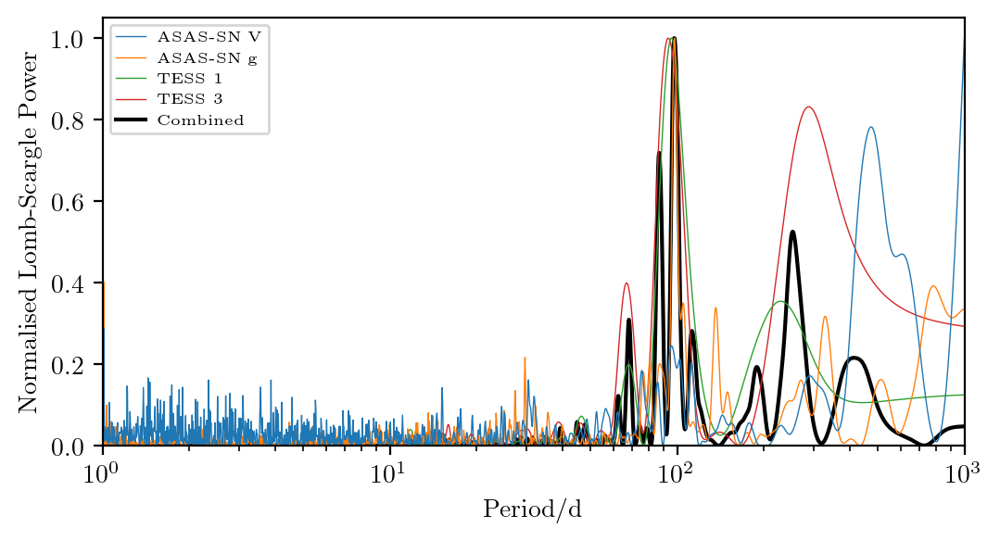

In [138]:
# periodogram analysis

from astropy import units as u
from astropy.timeseries import LombScargle
from scipy.integrate import trapz

f = 1/(np.logspace(0, 3, 2000) * u.d)

for i in range(5):
    if i in z:
        m = z == i
    else:
        m = slice(None, None)
        
    if i == 3:
        m = np.array([_ in (3, 4) for _ in z])
        
    if i == 4:
        m = slice(None, None)

    ls = LombScargle(x[m] * u.d, y[m], dy=e_y[m])
    p = ls.power(f, normalization='psd')
#     p[1/f.value > (x[m][-1] - x[m][0])] = np.nan
    label = f"{bands[i]}" if i < 4 else 'Combined'
    plt.semilogx(1/f, p / np.nanmax(p), lw=.5 if i < 4 else None,
                 label=label, c=f"C{i}" if i < 4 else 'black', zorder=-i)
    print(f"{label}: {1/f[np.argmax(p)]}")
    
plt.legend(fontsize='xx-small', loc='upper left')
plt.ylabel(r"Normalised Lomb-Scargle Power")
plt.xlabel(r"Period/d")
plt.ylim(0, None)
plt.xlim(1, 1e3)
for ext in dims:
    plt.gcf().set_size_inches(*dims[ext])
    plt.savefig(f"figures/ls-all.{ext}", bbox_inches='tight', transparent=True, dpi=300)
plt.show()

ASAS-SN: 98.6265846131282 d
TESS: 98.6265846131282 d


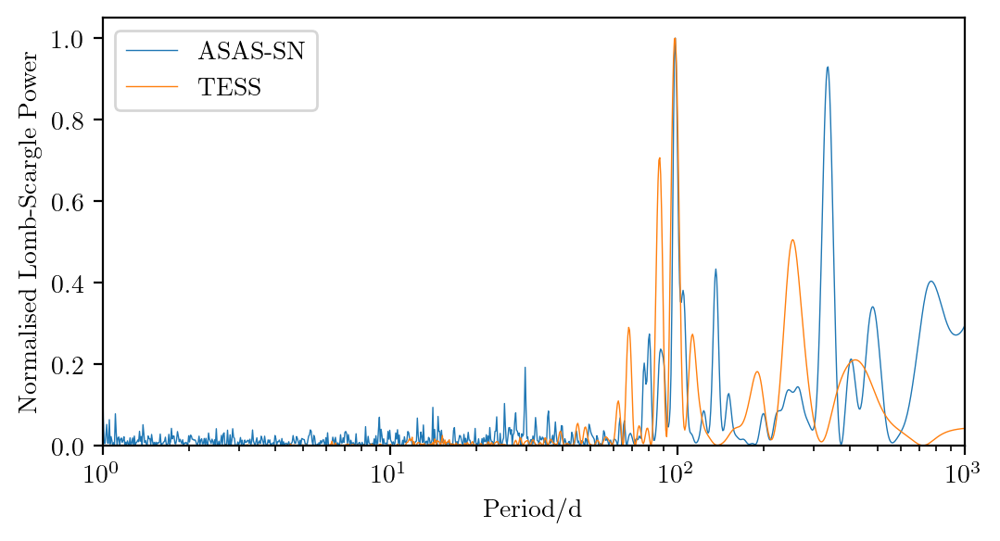

In [23]:
# Let's just segregate ASAS-SN vs. TESS

f = 1/(np.logspace(0, 3, 1000) * u.d)

for i in range(2):
    if i == 0:
        m = np.array([_ in (0, 1) for _ in z])
    elif i == 1:
        m = np.array([_ in (2, 3, 4) for _ in z])
    elif i == 2:
        m = slice(None, None)

    ls = LombScargle(x[m] * u.d, y[m], dy=e_y[m])
    p = ls.power(f, normalization='psd')
#     p[1/f.value > (x[m][-1] - x[m][0])] = np.nan
    label = f"{['ASAS-SN', 'TESS'][i]}" if i < 2 else 'Combined'
    plt.semilogx(1/f, p / np.nanmax(p), lw=.5 if i < 2 else None,
                 label=label, c=f"C{i}" if i < 2 else 'black')
    print(f"{label}: {1/f[np.argmax(p)]}")
    
plt.legend()
plt.ylabel(r"Normalised Lomb-Scargle Power")
plt.xlabel(r"Period/d")
plt.ylim(0, None)
plt.xlim(1, 1e3)
for ext in dims:
    plt.gcf().set_size_inches(*dims[ext])
    plt.savefig(f"figures/tess.{ext}", bbox_inches='tight', transparent=True, dpi=300)
plt.show()

In [24]:
f[np.argmax(p)].to(u.uHz)

<Quantity 0.11735248 uHz>

In [33]:
from astropy import units as u
from astropy.timeseries import LombScargle
from tqdm.auto import tqdm

# Since we can't do windowed FT or wavelets with nonuniformly sampled data,
# let's try to build up a Lomb-Scargle equivalent to the wavelet transform.

# Set up mesh of frequency and time values at which
# "wavelet" power spectrum is evaluated

tt = np.linspace(data['JD'][0], data['JD'][-1], 200)
ff = 1/(np.logspace(1, np.log10(1000), 400) * u.d)

# We will accumulate computation results in a bunch of arrays:
# one for each combination of bands

acc = [None for k in range(7)]

from wavelet import LS_wavelet

from os.path import isfile
if isfile("wavelet.npy"):
    acc = np.load("wavelet.npy", allow_pickle=True)[()]
else:
    for k in range(7):
        m = (z == k) if k in z else slice(None, None)
        acc[k] = LS_wavelet(tt, ff.value, x[m], y[m], e_y[m])
        if k in z:
            t_b = x[z == k]

            # To some extent the results already do this, but we now explicitly
            # zero out (or more accurately, NaN out) parts of the wavelet PS
            # outside of the temporal coverage of each data set.

            acc[k][(tt > np.max(t_b)) | (tt < np.min(t_b))] = np.nan

    np.save("wavelet.npy", acc)

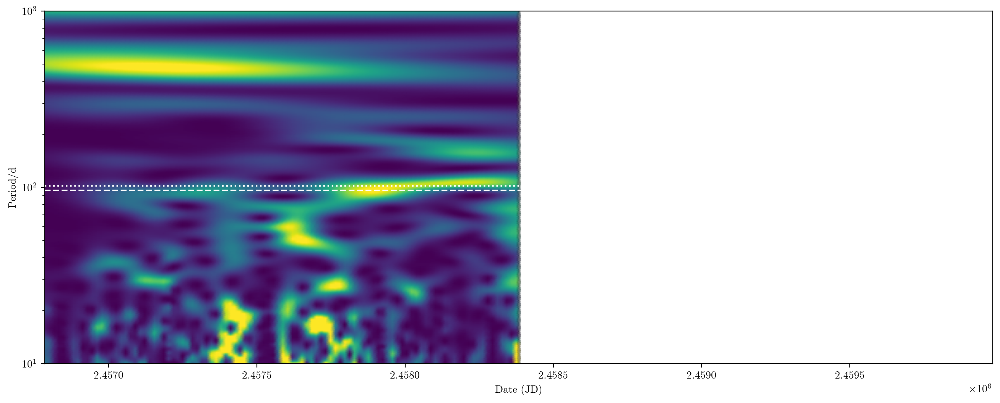

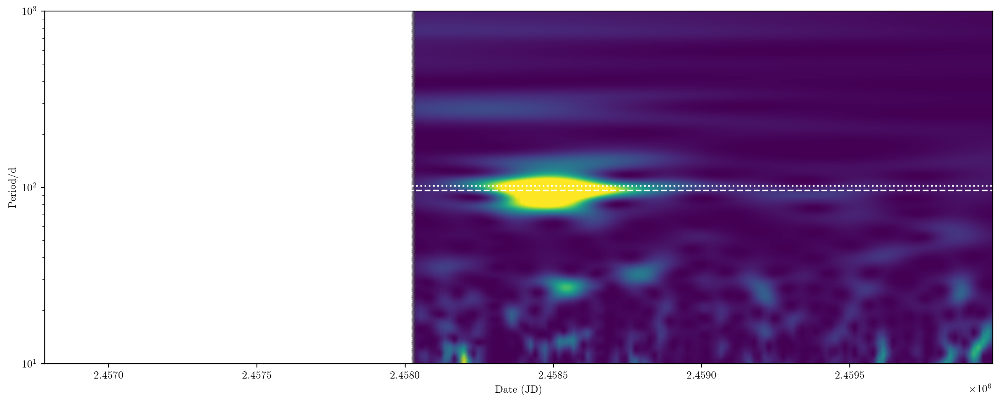

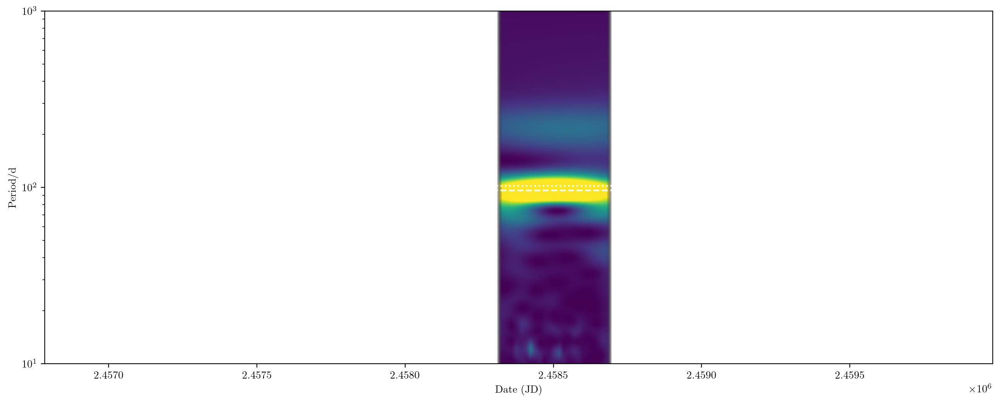

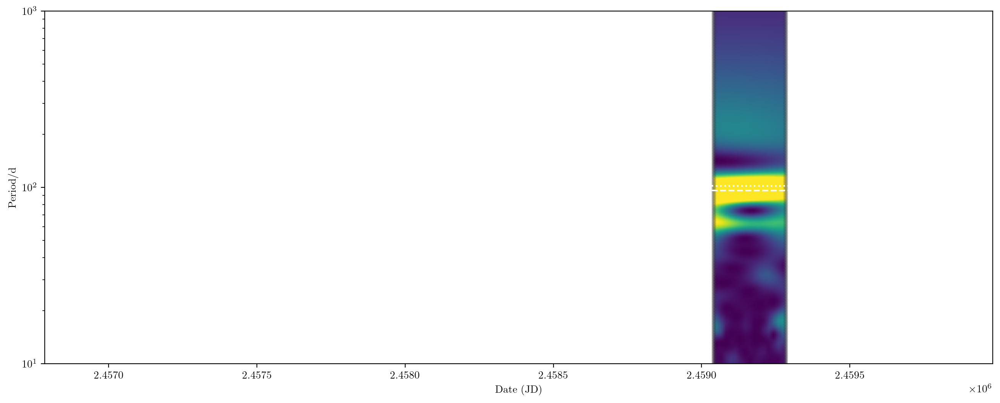

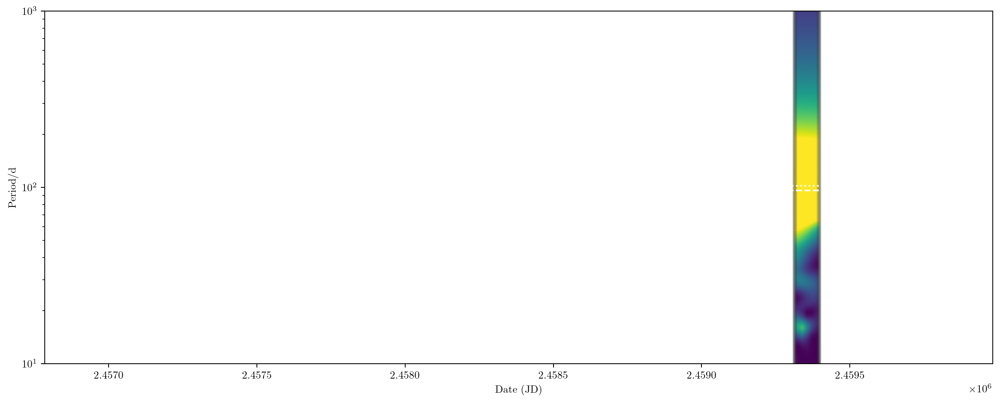

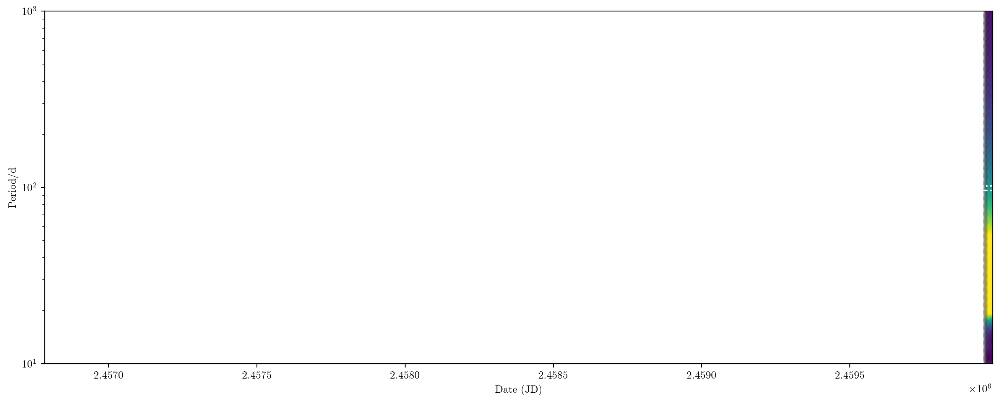

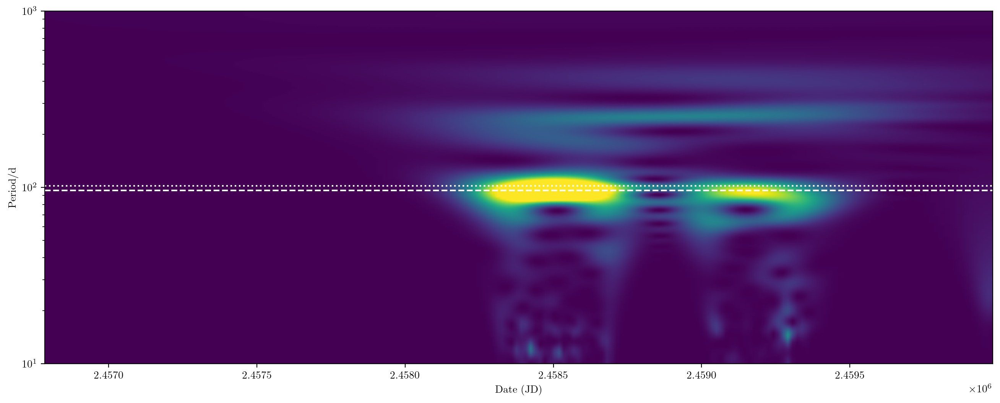

In [34]:
for i in range(7):
    plt.pcolormesh(tt, (1/ff).value, acc[i].T, shading='gouraud', vmin=0, vmax=np.nanmax(acc[i].T)/2)
    plt.gca().set_yscale('log')
    
    plt.axhline(102, c='white', ls='dotted')
    plt.axhline(96.3, c='white', ls='dashed')

    # plt.colorbar(label=r'Windowed Lomb-Scargle Power Density/$\mathrm{d}^{-1}$', pad=.005)
    plt.xlabel(r"Date (JD)")
    plt.ylabel(r"Period/d")
    plt.gcf().set_size_inches(16, 6)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


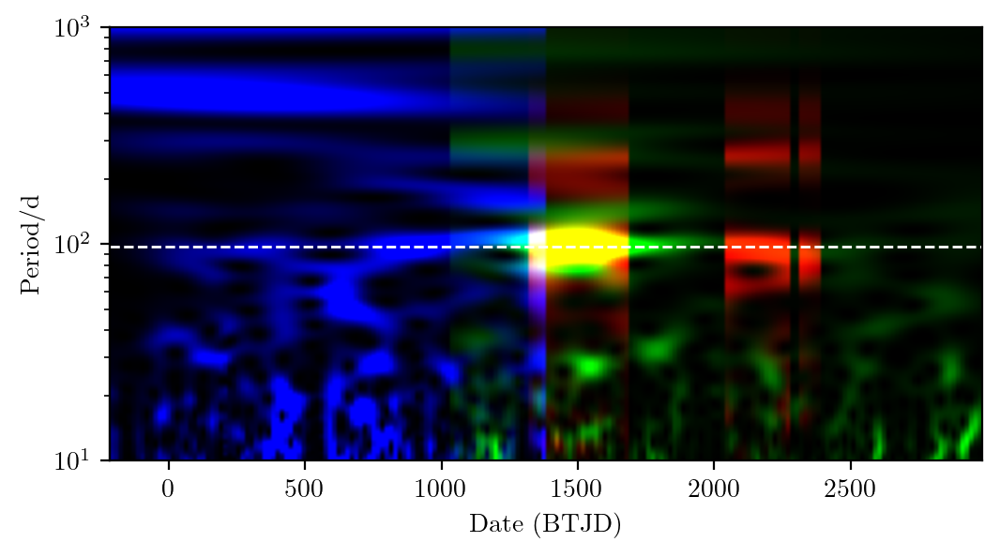

In [129]:
# generate RGB diagram

def norm(x):
    return x / np.nanmax(x)

img = [np.zeros_like(acc[-1]) for _ in range(3)]
for i in (0, 1, 2):
    if i == 0:
        m = np.any([(tt <= np.max(x[z == k])) & (tt >= np.min(x[z == k])) for k in (2,3,4)], axis=0) #TESS
    elif i == 1:
        m = np.any([(tt <= np.max(x[z == k])) & (tt >= np.min(x[z == k])) for k in (1,)], axis=0) #ASAS-SN g
    elif i == 2:
        m = np.any([(tt <= np.max(x[z == k])) & (tt >= np.min(x[z == k])) for k in (0,)], axis=0) #ASAS-SN V
        
    ref = acc[{0: -1, 1: 1, 2:0}[i]]
    img[i][m,:] = norm(ref[m,:])*3
    
img = np.array(img).transpose(2, 1, 0)
plt.imshow(img, origin='lower', aspect='auto', extent=(np.min(tt)-2457000, np.max(tt)-2457000, 1, 3))
# plt.axhline(np.log10(102), c='white', ls='dotted')
plt.axhline(np.log10(97.7), c='white', ls='dashed', lw=1)

# emulate log-scaled axes since imshow doesn't properly support this
from matplotlib.ticker import FixedLocator
plt.gca().yaxis.set_visible(False)
secax = plt.gca().secondary_yaxis('left', functions=(lambda x: np.power(10, x), np.log10))
secax.set_yticks([10, 100, 1000])
secax.set_yticklabels([f'$10^{i}$' for i in range(1, 4)])
secax.yaxis.set_minor_locator(FixedLocator(np.concatenate([10**i * np.arange(2, 10) for i in range(1, 3)])))
secax.set_ylabel(r"Period/d")

plt.xlabel(r"Date (BTJD)")

plt.gcf().set_size_inches(6,3)
for ext in dims:
#     plt.gcf().set_size_inches(*dims[ext])
    plt.savefig(f"figures/wavelet.{ext}", bbox_inches='tight', transparent=True, dpi=300)
plt.show()

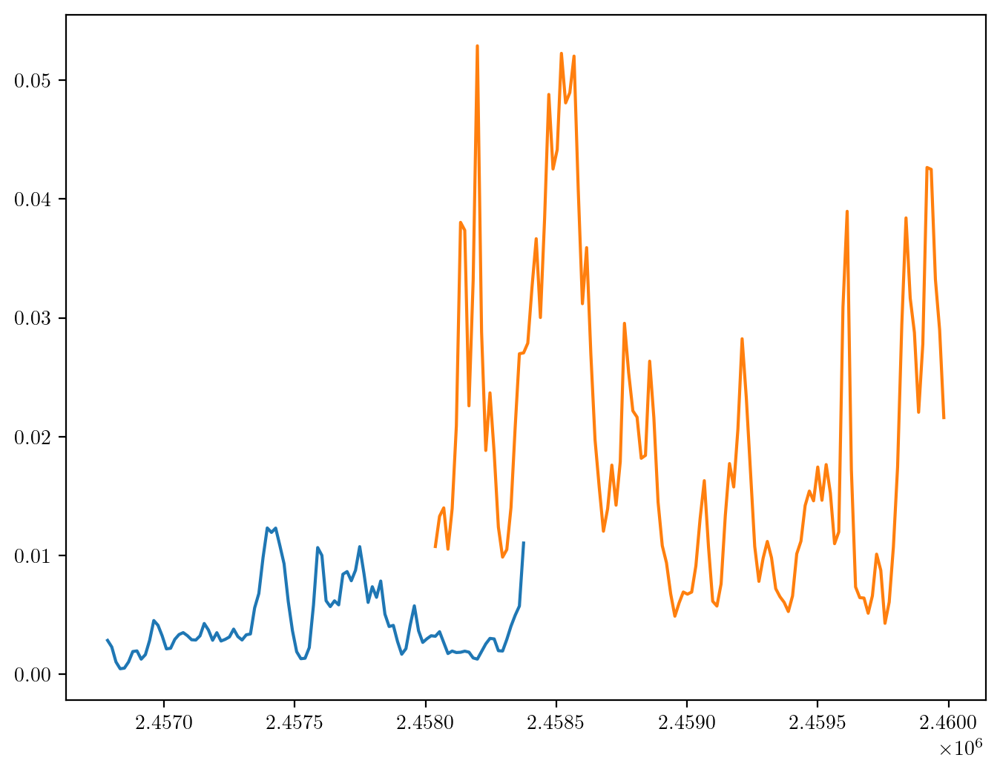

In [30]:
from scipy.integrate import trapz
for i in (0, 1,):
    plt.plot(tt, trapz(acc[i][:,::-1], ff[::-1]))

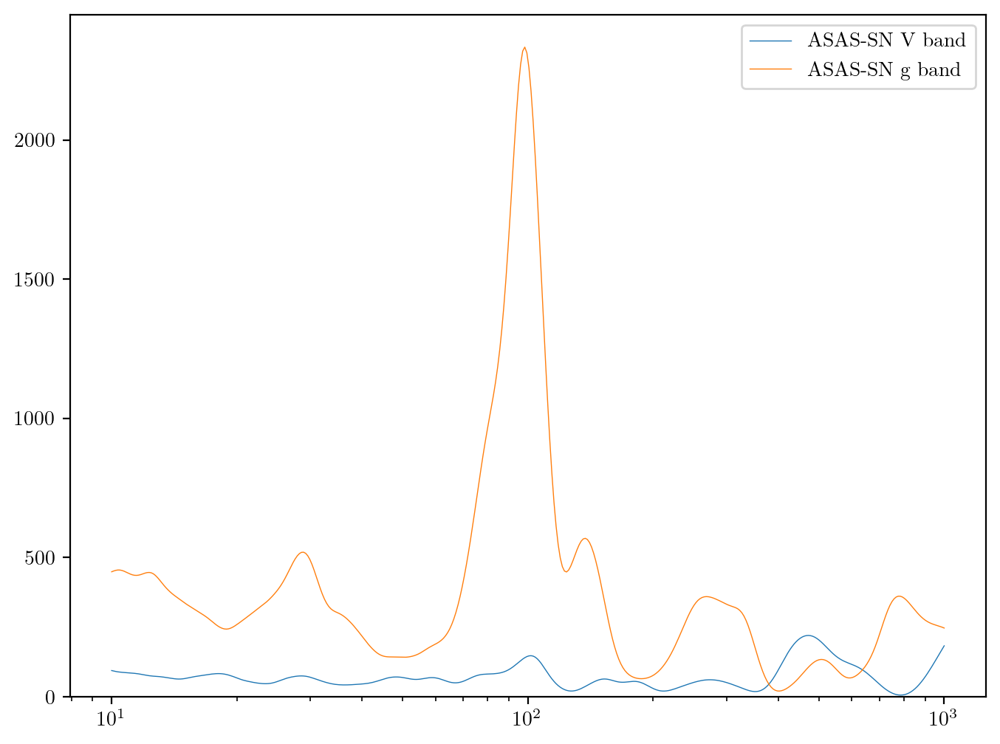

In [32]:
for i in (0, 1):
    plt.plot((1/ff).value, trapz(np.nan_to_num(acc[i]), tt, axis=0),lw=.5 if i < 2 else None, label=f"{bands[i]} band" if i < 2 else 'Combined', c=f"C{i}" if i < 2 else 'black')
plt.legend()
plt.gca().set_xscale('log')
plt.ylim(0, None)
plt.show()